###  **A Semi Supervised Learning notebook**

#### What is Semi Supervised Learning ??
##### A semi supervised learning is a learning technique in machine learning used when you have small amount of labelled data and large amount of unlabelled data.
#### Do we have different techniques to solve this approach ??
##### Yes, We do have a lot of approached like psuedo labelling, noisy student approaches.
#### What is the actual state-of-art behind the semi supervised learning ??
##### Take you labelled data normally as train and valid , consider your unlabelled data as test and predict the labells for it. Now, consider the predicted labelles as actual labells and re-train with new model upon the entire dataset.

I am going to use ALASKA2 Image Steganalysis data from kaggle

Data and problem statement explanation:

This is a open competition dataset has secret data hidden within digital images.The goal of this project is to develop a solution which helsp in identifying this secret messages within the images specially the type of algorithm used to cast this messages inside the images.

Different steganography algorithms: JMiPOD, JUNIWARD, UERD, etc, including those algorithms, which are not known during training time.

Stegenography is the process of hiding of a secret message within an ordinary message and extracting it at its destination.

Our idea behind this notebook is to be able to detect unseen/unknown steganographic algorithms.
A reasonable choice is to start with 2-class classification (- Stego, - Clean).
Whereas the 4-class classification (- JMiPOD, - JUNIWARD, - UERD, - Clean) seems too specific.


We are using a transfer learning approac to address this problem. we are going to use A semi supervised technique called noisy student weights and build more layers to address the classification problem.

### **This notebook needs TPU to run I have utilized the kaggle resources to generate and run this code**

Dataset Description :

--- Cover/ contains 75k unaltered images meant for use in training.
--- JMiPOD/ contains 75k examples of the JMiPOD algorithm applied to the cover images.
--- JUNIWARD/contains 75k examples of the JUNIWARD algorithm applied to the cover images.
--- UERD/ contains 75k examples of the UERD algorithm applied to the cover images.
--- Test/ contains 5k test set images. These are the images for which you are predicting.



In [3]:

# importing libraries
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 5GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/alaska2-image-steganalysis/sample_submission.csv
/kaggle/input/alaska2-image-steganalysis/UERD/52434.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/53584.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64575.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/46029.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/61852.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/16432.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/22048.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/42841.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/29517.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/40102.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/26511.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/22065.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/51153.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13782.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/38560.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/35875.jpg
/kaggle/input/alaska2-image-steganalysis/

/kaggle/input/alaska2-image-steganalysis/UERD/25111.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/23850.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/61378.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/28974.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/78611.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/57176.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/65084.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/67075.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/14212.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/61389.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/30430.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/42523.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/36323.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/44242.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/38126.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13933.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/19026.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/58

/kaggle/input/alaska2-image-steganalysis/UERD/24155.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/63581.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/04088.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64517.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/18192.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/32152.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/18216.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/35567.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/09080.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/27238.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/53554.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/55826.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/21458.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/22957.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/36046.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75021.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13918.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/46

/kaggle/input/alaska2-image-steganalysis/UERD/44015.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/12541.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/69540.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/34444.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/16167.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/35776.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/54885.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/44587.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/76207.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/65083.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/55852.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/03384.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/60593.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/02106.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/32927.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13639.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/36325.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/58

/kaggle/input/alaska2-image-steganalysis/UERD/67640.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/15949.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/34631.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/16707.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/20575.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64944.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/28871.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75450.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/69820.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/07158.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/72382.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/24618.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/57001.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/23678.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/15462.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13222.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/78518.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/26

/kaggle/input/alaska2-image-steganalysis/UERD/39411.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/72643.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/41977.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64972.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/04177.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/69774.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/21045.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/00261.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/18185.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/31538.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/27691.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/42654.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/27661.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/09335.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13718.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/21738.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/03953.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/38

/kaggle/input/alaska2-image-steganalysis/UERD/55638.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/55075.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/79211.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75477.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/01869.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/02920.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/78296.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/07344.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/11585.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/20723.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64090.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/77132.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/41792.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/01787.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/24219.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/12392.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/28379.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/09

/kaggle/input/alaska2-image-steganalysis/UERD/30738.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/50872.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/10668.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/51240.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/79381.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/54239.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/20542.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/68943.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/49197.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/49508.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/42743.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/19819.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/53260.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/23989.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75068.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/58095.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/35241.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/63

/kaggle/input/alaska2-image-steganalysis/UERD/16254.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/78355.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/77785.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/08548.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/61260.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/34897.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/24505.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/53585.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75097.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/45191.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/09917.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/42377.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/63537.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/59524.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/21041.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/34182.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/28728.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/00

/kaggle/input/alaska2-image-steganalysis/UERD/03983.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/69772.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/36565.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/37517.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/57868.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/47038.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/17475.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/14311.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/55531.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/32241.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/06073.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/24371.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/12415.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75550.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/18894.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/20059.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/08962.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/53

/kaggle/input/alaska2-image-steganalysis/UERD/74105.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/11268.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/27061.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/37697.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/17732.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/41351.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/53283.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/17196.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/76127.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/04711.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/16423.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13831.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/27456.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/41182.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/46004.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/51500.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/60006.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/31

/kaggle/input/alaska2-image-steganalysis/UERD/22158.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/35396.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/08198.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/07114.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/52200.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/76730.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/28326.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/27563.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/18768.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/31612.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/53903.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/21586.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/40441.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/26794.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/15343.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/29240.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13493.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/40

/kaggle/input/alaska2-image-steganalysis/UERD/19912.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/36073.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/47443.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/46338.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/06574.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/50211.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64372.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/09738.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/57570.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/01875.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/21365.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/60385.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/73873.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/55697.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/51474.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/02305.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/60957.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/73

/kaggle/input/alaska2-image-steganalysis/UERD/63083.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/45774.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64709.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/70841.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/71477.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/07488.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/22663.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/24327.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/65051.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/21587.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/73269.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64145.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/79477.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/24619.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64134.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/08498.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/59116.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/46

/kaggle/input/alaska2-image-steganalysis/UERD/48556.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64526.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/62082.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/43426.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/79555.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75729.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13710.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/33821.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/53317.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/02613.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/25678.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/22259.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/78438.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/18304.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/42937.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/30215.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/31051.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/59

/kaggle/input/alaska2-image-steganalysis/UERD/51904.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/15995.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/69740.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/36853.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/28591.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/48915.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/22718.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/67903.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/47448.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/35173.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/29135.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/40135.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/39038.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/14265.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/63917.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/04567.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/31714.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/10

/kaggle/input/alaska2-image-steganalysis/UERD/43807.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13660.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/52723.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/65869.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/07144.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/38421.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/54141.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/38537.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/55821.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/21707.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/22429.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/35743.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/19291.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/60883.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/30778.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75898.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/11434.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/34

/kaggle/input/alaska2-image-steganalysis/UERD/68073.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/71660.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/48304.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/46148.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/08732.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/70006.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/34879.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/78905.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/28513.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/38259.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13159.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/34617.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/57794.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/68200.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/03894.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/52212.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/38652.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/36

/kaggle/input/alaska2-image-steganalysis/UERD/25003.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/66447.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/67199.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/26314.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/53435.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/08186.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75662.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/60403.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/47472.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/46975.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/07379.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/34313.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/55421.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/11102.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/39067.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/38320.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/59440.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/78

/kaggle/input/alaska2-image-steganalysis/UERD/66552.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/69234.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/61228.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/39122.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/33117.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/61612.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/20286.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/42723.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/30811.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/44564.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/51369.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/54484.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/57133.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/28627.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/08414.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/18020.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/23243.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/14

/kaggle/input/alaska2-image-steganalysis/UERD/69669.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/76576.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/67880.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/21832.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/66116.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/73721.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/66951.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/05063.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/27350.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/52533.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/48894.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/05185.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/31028.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/74510.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/22593.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/49946.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/07116.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/63

/kaggle/input/alaska2-image-steganalysis/UERD/48108.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/02345.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/35449.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/20329.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/37917.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13049.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/09281.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/70433.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/11129.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/27651.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/10623.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/31321.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/04890.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/56975.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/14846.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/29841.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/38006.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/31

/kaggle/input/alaska2-image-steganalysis/UERD/20103.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/31113.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/32112.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/08299.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/55369.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/72997.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/34664.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/33189.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/74342.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/76620.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/33778.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/21976.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/14356.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/61124.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/08458.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/35571.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/34282.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/63

/kaggle/input/alaska2-image-steganalysis/UERD/14786.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/67339.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/31363.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/06339.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64795.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/00739.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/56191.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/78344.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/40107.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/21917.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/24361.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/41275.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/74884.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/48253.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/07400.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/38511.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/41394.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/46

/kaggle/input/alaska2-image-steganalysis/UERD/47700.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/56582.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/39688.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/68683.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/46348.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/10185.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/20132.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/59721.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/24401.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/55611.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/23182.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/50944.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/56867.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/12581.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/45277.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/62239.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/44353.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/61

/kaggle/input/alaska2-image-steganalysis/UERD/25639.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/24226.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/03260.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/15645.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/35145.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/30091.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/74409.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/11761.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/37466.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/71113.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/60372.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/17999.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/08506.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/54472.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/11059.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/56811.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/02383.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/03

/kaggle/input/alaska2-image-steganalysis/UERD/13255.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/38738.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/70418.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/04392.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/26077.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/18553.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/42911.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/38504.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/76033.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13282.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/04131.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/47998.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/42007.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/61981.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/32975.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/59406.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/49357.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/38

/kaggle/input/alaska2-image-steganalysis/UERD/13318.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/63529.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/69376.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/09053.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/07420.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75586.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/72507.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/11475.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/35150.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/07411.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/32024.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/37762.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64773.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/39124.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/09831.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/20552.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/79884.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/23

/kaggle/input/alaska2-image-steganalysis/UERD/75962.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/04106.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64473.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/23133.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/05026.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75628.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/72542.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/30966.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/67360.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/69490.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/34253.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/63600.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/53120.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/05467.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/39543.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/35763.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75352.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/36

/kaggle/input/alaska2-image-steganalysis/UERD/57048.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/59233.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/16170.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/37861.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/31667.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64371.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/16952.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/70504.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/50184.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/09949.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/44490.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/69845.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/71291.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/79796.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/26663.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/37541.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/16240.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/25

/kaggle/input/alaska2-image-steganalysis/UERD/12965.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/44007.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/79340.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75113.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/27035.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/34066.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/40030.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/73794.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/73418.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/55257.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/73764.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/18627.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/55428.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/67054.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/77211.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/31084.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/43970.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/62

/kaggle/input/alaska2-image-steganalysis/UERD/38958.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/76380.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/44891.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/77297.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13287.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/07315.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13551.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/61921.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64750.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/44648.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/55125.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64938.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/01476.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/22645.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/78425.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/68037.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/54085.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/63

/kaggle/input/alaska2-image-steganalysis/UERD/76606.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/61924.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/58402.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75676.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/21601.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/12083.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/44478.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/52085.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/04999.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/57262.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/29022.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/08090.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/47199.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/11115.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/79094.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/03007.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/20380.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/03

/kaggle/input/alaska2-image-steganalysis/UERD/26842.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/69224.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/48560.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75232.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/38225.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/57859.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/69279.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/42319.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/11215.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/08296.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/69649.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/07305.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/61754.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/09087.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/51487.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/15084.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/20126.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/38

/kaggle/input/alaska2-image-steganalysis/UERD/38966.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/62627.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/52801.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/67637.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/12224.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/74430.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/51834.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/64849.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/78317.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/01609.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/39004.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/58676.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/12729.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/45510.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/76211.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/68876.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/08073.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/09

/kaggle/input/alaska2-image-steganalysis/UERD/05136.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/61741.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/04828.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/33084.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/62955.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/59643.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/15075.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/14320.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/68999.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/18244.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/00257.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/27490.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/58564.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/22493.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/63934.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/41583.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/55692.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/76

/kaggle/input/alaska2-image-steganalysis/UERD/41673.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/60824.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/27135.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/50102.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/05966.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/58863.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/68317.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/36170.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/49366.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/37603.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/62704.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/58559.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/33541.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/05731.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/34826.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/21511.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/34988.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/17

/kaggle/input/alaska2-image-steganalysis/UERD/68357.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/12924.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/14309.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/13947.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/46893.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/26417.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/47517.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/31611.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/01594.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/52585.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/44877.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/76171.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/21635.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/75994.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/03732.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/04037.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/73838.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/66

/kaggle/input/alaska2-image-steganalysis/UERD/19296.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/49151.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/35749.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/57344.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/47002.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/68867.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/40594.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/23687.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/50202.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/09821.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/24105.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/61528.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/77987.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/14850.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/71560.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/55124.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/56917.jpg
/kaggle/input/alaska2-image-steganalysis/UERD/01

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/52434.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/53584.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/64575.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/46029.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/61852.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/16432.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/22048.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/42841.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/29517.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/40102.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/26511.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/22065.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/51153.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/13782.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/38560.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/35875.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/71653.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/56478.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/36964.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/46954.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/57173.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/58162.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/12210.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/49353.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/20737.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/66956.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/08924.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/27865.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/44715.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/44682.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/47665.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/01979.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/45154.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/64976.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/54745.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/52334.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/77243.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/09644.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/30199.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/60082.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/44617.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/35164.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/75836.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/63074.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/63312.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/35147.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/10997.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/47685.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/49909.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/76882.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/07827.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/08915.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/40179.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/79587.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/34618.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/35128.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/29117.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/26140.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/56894.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/02092.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/04773.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/74589.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/64660.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/34351.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/23416.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/63109.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/03287.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/00671.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/31040.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/08486.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/37647.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/57330.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/32155.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/22561.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/79484.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/21923.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/10990.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/36165.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/63465.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/44407.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/32087.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/03466.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/39247.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/10496.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/10698.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/12204.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/03605.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/47063.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/20087.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/74392.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/55345.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/52241.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/05864.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/33714.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/59267.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/67019.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/54286.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/79732.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/68028.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/04922.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/03810.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/28808.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/09653.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/78059.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/70925.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/74404.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/10032.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/60441.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/29306.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/09315.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/38801.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/60567.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/69703.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/56182.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/70527.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/04916.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/63794.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/75217.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/64840.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/41858.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/10955.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/16005.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/22693.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/70773.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/17700.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/01944.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/00425.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/09524.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/54010.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/08180.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/76914.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/75082.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/71316.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/58584.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/53426.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/06059.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/64192.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/06513.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/27610.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/38737.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/76504.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/27275.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/68602.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/20772.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/74580.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/67384.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/50572.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/68880.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/42279.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/37126.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/61299.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/37682.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/10394.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/39517.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/22166.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/41515.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/24931.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/66791.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/29015.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/07752.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/39291.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/47245.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/52337.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/72110.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/31558.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/09789.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/40673.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/59266.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/50222.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/67957.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/29686.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/27278.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/76810.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/08521.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/10122.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/55055.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/21092.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/58533.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/31811.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/39988.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/64277.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/20183.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/47720.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/63930.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/39935.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/13268.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/00253.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/07323.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/35081.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/48851.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/44894.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/08142.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/59926.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/15406.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/44755.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/02119.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/65058.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/34158.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/42079.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/26615.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/11173.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/67504.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/23472.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/41949.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/19744.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/43390.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/23899.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/15023.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/65337.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/58810.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/05638.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/61864.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/77051.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/28579.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/76158.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/09699.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/32093.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/16679.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/17017.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/12309.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/43389.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/15432.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/12590.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/35153.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/16599.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/58565.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/33935.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/64509.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/13302.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/41214.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/61269.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/45455.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/68013.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/67465.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/47526.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/04622.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/36022.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/08438.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/35258.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/05883.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/60072.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/74496.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/62220.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/23893.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/64805.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/60532.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/20706.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/29258.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/42683.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/41507.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/18918.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/76584.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/54323.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/41822.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/61908.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/04681.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/76643.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/48852.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/68290.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/51011.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/49078.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/79023.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/21703.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/59166.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/55856.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/62003.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/40565.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/69259.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/49281.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/07440.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/25023.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/09276.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/63320.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/49274.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/21127.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/29717.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/71991.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/33659.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/76102.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/27884.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/25864.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/32855.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/05337.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/05131.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/38927.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/26452.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/59443.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/48825.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/24643.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/79562.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/49346.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/25001.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/49449.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/04005.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/22424.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/72296.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/14155.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/70472.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/48993.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/15805.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/30974.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/61695.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/57477.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/50327.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/21971.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/72023.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/45188.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/10627.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/08905.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/16434.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/11831.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/73843.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/38360.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/47257.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/50734.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/04920.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/53544.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/65259.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/66683.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/55166.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/39693.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/02958.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/64819.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/50489.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/18960.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/77935.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/68955.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/39031.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/73934.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/26743.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/50159.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/33291.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/79336.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/50075.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/18729.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/79383.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/47287.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/60295.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/22694.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/04133.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/53509.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/28896.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/26008.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/24588.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/21046.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/68326.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/54823.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/59349.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/06222.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/71655.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/07698.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/57235.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/54738.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/60756.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/15004.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/15999.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/30486.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/02122.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/39737.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/58591.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/43549.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/01497.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/61363.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/06637.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/48444.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/56162.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/70128.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/75267.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/63301.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/55523.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/66682.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/60906.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/39318.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/62272.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/03099.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/53712.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/12123.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/14002.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/20410.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/39265.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/27237.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/02634.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/75694.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/38581.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/19092.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/71461.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/17411.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/32979.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/22529.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/74615.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/04099.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/38870.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/06874.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/30591.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/17794.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/00508.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/72205.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/26107.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/31367.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/57312.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/37844.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/52925.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/07235.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/29079.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/57754.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/42756.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/07267.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/36160.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/72033.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/62269.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/15705.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/28864.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/44393.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/38317.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/67197.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/71467.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/34738.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/28149.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/17134.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/53167.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/12950.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/40750.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/16492.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/73532.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/47003.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/49651.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/34890.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/40166.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/41902.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/78570.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/25268.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/51724.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/65214.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/75270.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/77023.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/70236.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/62181.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/28922.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/43189.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/51855.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/04191.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/56037.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/78564.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/59631.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/12908.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/70639.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/12095.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/24015.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/13901.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/33933.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/31059.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/43091.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/32937.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/23588.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/77717.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/20963.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/38754.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/12345.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/10695.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/47868.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/40760.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/41721.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/31620.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/09216.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/69528.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/24092.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/68223.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/67213.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/00424.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/22046.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/63300.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/18118.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/43438.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/26808.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/20296.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/57645.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/46677.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/32908.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/48470.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/29905.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/52133.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/68014.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/78511.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/19402.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/67973.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/07143.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/75709.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/44683.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/60807.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/13719.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/67622.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/28306.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/72218.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/71025.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/72895.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/50783.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/06097.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/45172.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/00919.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/18572.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/16021.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/36378.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/71751.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/77867.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/71619.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/71327.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/71428.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/75827.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/68864.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/73089.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/63356.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/24709.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/30493.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/34712.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/63355.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/58311.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/42675.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/25088.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/15354.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/01363.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/14090.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/28861.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/40214.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/68954.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/47321.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/39177.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/05363.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/03693.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/69296.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/48158.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/10303.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/19234.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/42478.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/37417.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/07443.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/72285.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/74188.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/00636.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/32231.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/12648.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/51841.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/34054.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/35361.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/17438.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/58312.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/46936.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/36512.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/18813.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/53735.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/58773.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/47729.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/37148.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/55786.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/57516.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/76258.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/39254.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/19070.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/33069.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/48394.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/52729.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/43154.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/67645.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/53063.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/01110.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/30439.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/53109.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/22930.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/35785.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/07623.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/28695.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/11954.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/56526.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/35505.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/17532.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/71928.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/14374.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/74021.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/69591.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/59679.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/18355.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/73816.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/60860.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/45472.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/15325.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/38334.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/21144.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/62193.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/45820.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/49685.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/14315.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/09212.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/07165.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/52615.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/61201.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/69513.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/04901.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/16709.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/46676.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/26636.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/11987.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/53945.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/58860.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/54037.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/71454.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/44545.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/17735.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/59596.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/48495.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/60429.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/24975.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/70984.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/10484.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/55895.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/77318.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/51273.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/33428.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/49451.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/78338.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/05735.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/56078.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/56041.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/65142.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/67794.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/09952.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/74335.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/33635.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/32961.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/09778.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/27919.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/45909.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/77821.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/55489.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/39905.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/36697.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/31951.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/32137.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/11279.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/23887.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/44382.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/39735.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/JUNIWARD/24650.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/76383.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/37896.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/24995.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/70134.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/63550.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/71408.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/31718.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/15674.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/75795.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/47891.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/18399.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/36916.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/34138.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/73490.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/71803.jpg
/kaggle/input/alaska2-image-steganalysis

/kaggle/input/alaska2-image-steganalysis/Test/1684.jpg
/kaggle/input/alaska2-image-steganalysis/Test/1153.jpg
/kaggle/input/alaska2-image-steganalysis/Test/0411.jpg
/kaggle/input/alaska2-image-steganalysis/Test/4886.jpg
/kaggle/input/alaska2-image-steganalysis/Test/0606.jpg
/kaggle/input/alaska2-image-steganalysis/Test/2447.jpg
/kaggle/input/alaska2-image-steganalysis/Test/1266.jpg
/kaggle/input/alaska2-image-steganalysis/Test/4416.jpg
/kaggle/input/alaska2-image-steganalysis/Test/0206.jpg
/kaggle/input/alaska2-image-steganalysis/Test/0341.jpg
/kaggle/input/alaska2-image-steganalysis/Test/2301.jpg
/kaggle/input/alaska2-image-steganalysis/Test/4276.jpg
/kaggle/input/alaska2-image-steganalysis/Test/1947.jpg
/kaggle/input/alaska2-image-steganalysis/Test/0748.jpg
/kaggle/input/alaska2-image-steganalysis/Test/2826.jpg
/kaggle/input/alaska2-image-steganalysis/Test/4228.jpg
/kaggle/input/alaska2-image-steganalysis/Test/2346.jpg
/kaggle/input/alaska2-image-steganalysis/Test/4766.jpg
/kaggle/in

/kaggle/input/alaska2-image-steganalysis/Test/1479.jpg
/kaggle/input/alaska2-image-steganalysis/Test/0335.jpg
/kaggle/input/alaska2-image-steganalysis/Test/1356.jpg
/kaggle/input/alaska2-image-steganalysis/Test/0150.jpg
/kaggle/input/alaska2-image-steganalysis/Test/3850.jpg
/kaggle/input/alaska2-image-steganalysis/Test/2012.jpg
/kaggle/input/alaska2-image-steganalysis/Test/3550.jpg
/kaggle/input/alaska2-image-steganalysis/Test/2877.jpg
/kaggle/input/alaska2-image-steganalysis/Test/1857.jpg
/kaggle/input/alaska2-image-steganalysis/Test/2156.jpg
/kaggle/input/alaska2-image-steganalysis/Test/0743.jpg
/kaggle/input/alaska2-image-steganalysis/Test/3786.jpg
/kaggle/input/alaska2-image-steganalysis/Test/1039.jpg
/kaggle/input/alaska2-image-steganalysis/Test/2799.jpg
/kaggle/input/alaska2-image-steganalysis/Test/3510.jpg
/kaggle/input/alaska2-image-steganalysis/Test/2180.jpg
/kaggle/input/alaska2-image-steganalysis/Test/4869.jpg
/kaggle/input/alaska2-image-steganalysis/Test/2596.jpg
/kaggle/in

/kaggle/input/alaska2-image-steganalysis/Test/2728.jpg
/kaggle/input/alaska2-image-steganalysis/Test/2218.jpg
/kaggle/input/alaska2-image-steganalysis/Test/3217.jpg
/kaggle/input/alaska2-image-steganalysis/Test/3483.jpg
/kaggle/input/alaska2-image-steganalysis/Test/2783.jpg
/kaggle/input/alaska2-image-steganalysis/Test/0986.jpg
/kaggle/input/alaska2-image-steganalysis/Test/4935.jpg
/kaggle/input/alaska2-image-steganalysis/Test/3724.jpg
/kaggle/input/alaska2-image-steganalysis/Test/3157.jpg
/kaggle/input/alaska2-image-steganalysis/Test/4538.jpg
/kaggle/input/alaska2-image-steganalysis/Test/0033.jpg
/kaggle/input/alaska2-image-steganalysis/Test/0491.jpg
/kaggle/input/alaska2-image-steganalysis/Test/0908.jpg
/kaggle/input/alaska2-image-steganalysis/Test/3768.jpg
/kaggle/input/alaska2-image-steganalysis/Test/0143.jpg
/kaggle/input/alaska2-image-steganalysis/Test/0685.jpg
/kaggle/input/alaska2-image-steganalysis/Test/1912.jpg
/kaggle/input/alaska2-image-steganalysis/Test/3400.jpg
/kaggle/in

/kaggle/input/alaska2-image-steganalysis/Cover/52434.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/53584.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/64575.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/46029.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/61852.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/16432.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/22048.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/42841.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/29517.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/40102.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/26511.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/22065.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/51153.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/13782.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/38560.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/35875.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/67448.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/13938.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/42963.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/08248.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/63173.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/30071.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/24297.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/64628.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/70981.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/14652.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/36666.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/65991.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/49834.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/34619.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/43650.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/74587.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/03200.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/51518.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/54274.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/15304.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/08389.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/67750.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/60553.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/21895.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/79695.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/00737.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/07793.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/23797.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/26955.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/19436.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/09440.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/16083.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/34274.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/25731.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/79066.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/10476.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/21994.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/37018.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/32274.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/28283.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/74117.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/36751.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/68937.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/53172.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/40332.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/65215.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/61409.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/37421.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/76955.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/53210.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/16044.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/51895.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/08761.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/24744.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/72660.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/07404.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/07249.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/43734.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/55508.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/13223.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/74275.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/13948.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/44427.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/56601.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/50517.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/55323.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/61497.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/12856.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/04489.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/33466.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/04846.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/09181.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/19359.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/59833.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/74741.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/26665.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/46419.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/53010.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/38912.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/76954.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/44993.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/50528.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/14226.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/45813.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/35689.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/57256.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/09489.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/61505.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/70898.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/47325.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/32615.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/44543.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/24080.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/68359.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/44152.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/36610.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/65086.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/08480.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/37493.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/43751.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/72831.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/69420.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/28429.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/23365.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/76146.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/40854.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/65454.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/52477.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/55301.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/24806.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/24915.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/63871.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/30083.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/10085.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/20644.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/10251.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/17285.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/18902.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/72774.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/65165.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/15990.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/41194.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/29198.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/26376.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/51287.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/19673.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/05312.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/24022.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/12996.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/01027.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/15482.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/22788.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/37518.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/24249.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/24160.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/28945.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/17574.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/40084.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/57134.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/42297.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/62046.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/35693.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/17689.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/38900.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/55462.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/46782.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/59300.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/29649.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/39597.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/11079.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/00716.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/78846.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/17542.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/23417.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/45962.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/77747.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/38211.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/56779.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/58057.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/22215.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/78161.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/26853.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/49751.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/58004.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/23295.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/27366.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/52046.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/36542.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/47241.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/18316.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/55513.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/72970.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/04985.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/57294.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/51020.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/34262.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/79061.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/55667.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/65116.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/57131.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/37225.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/19636.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/02759.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/52739.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/76008.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/54252.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/21477.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/73077.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/45170.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/68382.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/25567.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/76570.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/61956.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/60378.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/63909.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/67928.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/49186.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/08735.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/45067.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/59321.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/63773.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/31099.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/52078.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/74641.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/64625.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/51914.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/70522.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/45434.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/71094.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/02173.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/35501.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/61380.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/33994.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/35099.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/30084.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/16768.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/11864.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/58325.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/47240.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/57796.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/79075.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/59343.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/39770.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/32643.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/77186.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/01878.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/74436.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/06155.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/00410.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/43707.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/50689.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/29819.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/74546.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/63889.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/19731.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/38096.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/71569.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/27843.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/38330.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/69685.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/50902.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/11747.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/54347.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/66172.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/79638.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/76161.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/72604.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/03484.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/43128.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/51006.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/73064.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/24210.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/54321.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/10157.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/38676.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/28738.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/28459.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/44517.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/12663.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/04462.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/58949.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/12775.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/22579.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/01924.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/16110.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/15290.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/72572.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/40463.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/27092.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/56581.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/25609.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/02461.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/56839.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/35035.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/79177.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/40697.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/26926.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/74782.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/13165.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/32982.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/77595.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/73438.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/75958.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/75007.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/11782.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/40190.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/03762.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/32995.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/47521.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/73823.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/06515.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/03141.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/15833.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/59347.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/56282.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/65874.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/67589.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/35860.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/10373.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/58125.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/44552.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/50289.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/49581.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/00018.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/39521.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/49062.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/32952.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/24484.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/51998.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/27753.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/36262.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/13605.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/53363.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/03708.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/24877.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/63386.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/53517.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/34153.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/40105.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/54087.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/00494.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/39639.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/59914.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/59093.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/18691.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/44008.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/00429.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/47782.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/75651.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/13451.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/78731.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/33656.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/76989.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/56207.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/40181.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/65398.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/17731.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/61524.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/49430.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/70833.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/24319.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/66183.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/37867.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/28714.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/29852.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/56621.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/64244.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/74236.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/50320.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/58723.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/47159.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/72383.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/30815.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/18846.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/74939.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/43334.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/56796.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/62586.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/07154.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/20983.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/34269.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/02937.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/07119.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/66209.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/46831.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/22446.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/55524.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/40443.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/75920.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/71959.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/16968.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/28473.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/11421.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/60908.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/75571.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/79696.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/25244.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/36238.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/26658.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/66101.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/42556.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/11247.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/44134.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/51422.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/07450.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/08745.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/01832.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/58098.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/43294.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/52072.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/66199.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/53374.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/41432.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/63836.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/77169.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/62152.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/67824.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/43783.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/65229.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/07129.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/23421.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/74835.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/09529.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/15454.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/26863.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/20111.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/32652.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/61750.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/41564.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/36452.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/40048.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/19706.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/01011.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/11347.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/78878.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/43569.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/74447.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/23229.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/31108.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/22115.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/28441.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/29908.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/30963.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/65830.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/61805.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/71035.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/70989.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/12301.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/66233.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/77470.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/21216.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/33294.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/03868.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/44834.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/71429.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/72049.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/26935.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/05963.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/05088.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/45749.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/19111.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/70800.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/49300.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/55337.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/16950.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/04205.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/08546.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/33647.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/61275.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/60148.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/61824.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/10413.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/53665.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/43205.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/05487.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/09318.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/36687.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/76937.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/65526.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/25175.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/40876.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/44302.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/38849.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/73456.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/23112.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/65155.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/47035.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/31222.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/32925.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/48591.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/76441.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/70669.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/77346.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/50613.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/79895.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/24215.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/43010.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/20951.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/72795.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/64837.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/52222.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/50498.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/44437.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/55383.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/13744.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/63134.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/25635.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/14826.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/01193.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/48571.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/50966.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/52411.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/41869.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/52593.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/40562.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/70488.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/78310.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/41069.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/66004.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/55750.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/71217.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/36002.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/49270.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/05012.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/78452.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/75584.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/76449.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/44814.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/63335.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/15631.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/56270.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/48797.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/49901.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/62654.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/31631.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/37223.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/62765.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/62565.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/61498.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/19060.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/00497.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/78815.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/43633.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/61097.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/66403.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/52342.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/19522.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/08574.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/36678.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/73413.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/25877.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/29046.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/53803.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/78721.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/59055.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/07676.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/66334.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/06684.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/63453.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/02366.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/01029.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/63533.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/61241.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/28763.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/69973.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/09393.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/67867.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/07620.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/27154.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/33460.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/39120.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/38866.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/42276.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/13645.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/40096.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/04152.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/35403.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/03176.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/53916.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/45004.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/34395.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/63665.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/28835.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/31622.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/57621.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/22762.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/37047.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/61003.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/74370.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/20327.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/27347.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/19584.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/29406.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/29166.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/56124.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/27474.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/55134.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/27911.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/72865.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/70766.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/34467.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/55250.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/63572.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/07441.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/15513.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/38720.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/41421.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/51978.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/45297.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/01901.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/35627.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/19501.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/60890.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/47579.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/40328.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/54575.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/24286.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/25537.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/54842.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/28812.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/76236.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/50967.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/40266.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/22342.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/35834.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/19035.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/55541.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/70458.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/10482.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/35681.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/23530.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/41747.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/67380.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/41740.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/46749.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/70113.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/70711.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/00663.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/41291.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/79291.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/64268.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/63425.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/35919.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/02314.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/33783.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/57354.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/73803.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/33902.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/01445.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/10974.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/60429.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/24975.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/70984.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/10484.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/55895.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/77318.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/51273.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/33428.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/49451.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/78338.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/05735.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/56078.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/56041.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/65142.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/67794.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/09952.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/66843.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/41162.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/69438.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/66373.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/64892.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/40104.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/05077.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/08330.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/64991.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/07382.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/32512.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/15906.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/46008.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/77259.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/17405.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/21201.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/59289.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/22089.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/Cover/03294.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/72284.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/58545.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/31510.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/63634.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/40995.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/03888.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/60668.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/67931.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/69596.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/48657.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/77781.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/71065.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/43308.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/04679.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/79924.jpg
/kaggle/input/alaska2-image-steganalysis/Cover/22052.jpg
/kaggle/input/alaska2-image-ste

/kaggle/input/alaska2-image-steganalysis/JMiPOD/52434.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/53584.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/64575.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/46029.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/61852.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/16432.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/22048.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/42841.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/29517.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/40102.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/26511.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/22065.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/51153.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/13782.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/38560.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/35875.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/67448.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/65555.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/40575.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/03556.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/10265.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/14877.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/30700.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/10171.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/06371.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/65196.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/58280.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/42691.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/70749.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/75862.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/43443.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/72760.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/57564.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/44409.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/48840.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/74276.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/38185.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/17712.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/45030.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/46867.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/14731.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/09098.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/51856.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/71752.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/69318.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/39782.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/59855.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/45419.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/67016.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/38711.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/05667.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/31704.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/59786.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/30917.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/60874.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/17763.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/25962.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/35351.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/57773.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/17826.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/18190.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/54084.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/48201.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/56129.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/40264.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/73923.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/52516.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/18262.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/59632.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/21023.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/12758.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/68276.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/70114.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/52611.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/05555.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/36193.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/63461.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/26449.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/05078.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/35152.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/14142.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/60992.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/36683.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/78525.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/35504.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/28694.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/10657.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/76197.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/43673.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/37684.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/23279.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/76530.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/59727.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/58815.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/24309.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/67752.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/37992.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/04713.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/41169.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/29419.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/18536.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/47033.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/76563.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/77183.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/66000.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/30406.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/26846.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/08155.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/04648.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/79993.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/23045.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/35194.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/40196.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/36028.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/19668.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/17281.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/44998.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/70000.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/02102.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/63248.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/09832.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/34429.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/37092.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/31844.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/29359.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/55924.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/69616.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/44830.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/79969.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/70262.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/41892.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/65187.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/52971.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/50553.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/05608.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/24399.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/78358.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/76948.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/73112.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/77464.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/53298.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/34028.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/77577.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/68050.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/37755.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/74384.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/42322.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/09472.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/72557.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/24558.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/01342.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/68647.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/16714.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/53114.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/72949.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/12912.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/75931.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/38445.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/54726.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/65404.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/19825.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/73209.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/31607.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/49189.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/31651.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/32917.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/12408.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/51046.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/28188.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/14702.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/42240.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/68170.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/00027.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/50393.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/15364.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/29559.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/17812.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/23839.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/04766.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/36590.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/20497.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/40677.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/02125.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/03023.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/40261.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/32213.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/28318.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/24925.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/20225.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/06198.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/41166.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/43594.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/10998.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/42469.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/69523.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/26984.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/02582.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/52496.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/53133.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/75960.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/46144.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/11339.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/69162.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/70615.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/17444.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/14004.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/25680.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/73244.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/45000.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/20541.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/41083.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/56186.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/50029.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/45765.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/47383.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/31660.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/05183.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/51256.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/14534.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/09763.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/07434.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/03756.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/62411.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/44483.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/13594.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/31637.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/34878.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/36305.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/00579.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/66648.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/52238.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/20689.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/66267.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/32720.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/47384.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/77039.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/69854.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/66694.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/78247.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/39794.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/78149.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/34731.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/74736.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/39759.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/32697.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/33281.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/70957.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/48235.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/62746.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/35624.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/03744.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/57565.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/74864.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/32890.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/26687.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/50516.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/40590.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/37470.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/07405.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/23595.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/54749.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/38873.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/79389.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/75195.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/62083.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/26515.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/43953.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/01738.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/02664.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/13582.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/50673.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/04787.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/61435.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/18371.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/76888.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/77327.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/31879.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/31917.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/23034.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/70339.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/36642.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/65612.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/60069.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/77860.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/47235.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/71543.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/79613.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/06065.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/58411.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/10150.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/07916.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/23835.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/10769.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/43873.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/05159.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/72757.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/54488.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/54850.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/76874.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/58715.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/59187.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/46586.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/33160.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/01147.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/64448.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/55040.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/61492.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/53875.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/48127.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/38274.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/41990.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/26611.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/23174.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/24044.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/25763.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/15703.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/10198.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/73530.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/50493.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/14539.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/29250.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/51174.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/21583.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/21879.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/25416.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/23201.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/37418.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/51253.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/31428.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/25338.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/07130.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/13526.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/22485.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/46804.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/32359.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/15942.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/41349.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/32046.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/51746.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/23936.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/42491.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/76778.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/15712.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/32173.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/30633.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/68043.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/22367.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/04311.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/68591.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/74556.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/57488.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/01525.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/62146.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/11263.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/56734.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/49524.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/37850.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/09693.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/55900.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/30209.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/00417.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/37972.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/79750.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/79053.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/57852.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/62599.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/04739.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/45121.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/27768.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/06767.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/64286.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/40125.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/12991.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/68460.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/62593.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/67912.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/63166.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/26131.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/00432.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/79117.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/57953.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/38986.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/20103.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/31113.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/32112.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/08299.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/55369.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/72997.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/34664.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/33189.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/74342.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/01666.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/59857.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/07375.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/21230.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/36813.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/14074.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/45870.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/66163.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/44041.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/19360.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/24113.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/66537.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/06877.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/07715.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/57418.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/76943.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/62513.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/27083.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/48472.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/55577.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/11672.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/29418.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/71005.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/73197.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/09126.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/48212.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/33137.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/42908.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/16919.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/08136.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/03918.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/11923.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/05180.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/50372.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/51618.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/33823.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/46506.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/49829.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/55609.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/39614.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/66308.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/42255.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/52843.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/30998.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/70122.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/58629.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/64204.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/61843.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/27642.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/22240.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/71707.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/19248.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/63764.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/54975.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/74505.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/58490.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/61609.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/38622.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/59310.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/40666.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/64612.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/28036.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/63272.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/55197.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/00491.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/09247.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/02724.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/22883.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/58130.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/50116.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/62571.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/64896.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/75234.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/76656.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/29504.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/66889.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/12952.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/61982.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/33343.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/10667.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/11126.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/43961.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/61450.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/29770.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/04003.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/41360.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/79250.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/53437.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/24894.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/33798.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/21986.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/03681.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/00557.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/46869.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/72378.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/21554.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/54945.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/12426.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/36381.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/75441.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/46600.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/78225.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/31498.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/44413.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/63440.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/77899.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/61850.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/34492.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/50721.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/52023.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/22362.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/01771.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/20245.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/33687.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/26061.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/73190.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/14000.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/33345.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/30031.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/51145.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/53021.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/05272.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/53358.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/36286.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/55610.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/46342.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/46147.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/60089.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/78325.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/39499.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/67221.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/60326.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/18211.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/16329.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/44811.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/63858.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/04064.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/44613.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/54418.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/13027.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/11840.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/52044.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/34121.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/72289.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/58708.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/10711.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/28802.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/27149.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/18881.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/71458.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/36153.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/44973.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/13487.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/41265.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/14319.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/20243.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/79836.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/21234.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/33225.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/61749.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/29897.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/48032.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/26247.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/30389.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/04601.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/29510.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/28116.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/77933.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/33166.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/70655.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/27999.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/22197.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/44857.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/17453.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/65175.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/76257.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/30664.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/78807.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/19382.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/22112.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/65430.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/03872.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/65305.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/37818.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/09496.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/76793.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/38590.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/48945.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/15939.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/05514.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/40830.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/13961.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/50950.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/63389.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/65292.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/31843.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/43124.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/40887.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/64587.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/73647.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/59622.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/47539.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/18451.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/14446.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/52099.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/25556.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/14204.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/67596.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/12806.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/15831.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/12385.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/67930.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/40762.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/37814.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/55438.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/39583.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/32730.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/72290.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/71091.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/70940.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/07126.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/23719.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/57718.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/34889.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/16753.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/10560.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/25830.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/07029.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/16383.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/20861.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/02727.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/00427.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/01306.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/51985.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/13717.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/53144.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/00127.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/37105.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/33542.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/23988.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/76818.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/09108.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/47641.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/50565.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/76938.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/20840.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/70051.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/09705.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/72354.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/70902.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/30210.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/24916.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/14675.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/02570.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/73907.jpg
/kaggle/input/

/kaggle/input/alaska2-image-steganalysis/JMiPOD/16067.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/31503.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/14043.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/15328.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/43307.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/02661.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/56611.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/34602.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/48946.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/62803.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/45540.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/41826.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/16589.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/25030.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/03202.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/50979.jpg
/kaggle/input/alaska2-image-steganalysis/JMiPOD/73739.jpg
/kaggle/input/

In [4]:
import numpy as np 
import pandas as pd 
import os

from tensorflow.keras.utils import plot_model
from IPython.display import Image


In [5]:
from tensorboard.plugins.hparams import api as hp
from keras.utils import to_categorical
import tensorflow as tf
print("TensorFlow version: ", tf.__version__)
# assert version.parse(tf.__version__).release[0] >= 2, \
#     "This notebook requires TensorFlow 2.0 or above."
from datetime import datetime
%load_ext tensorboard
# %reload_ext tensorboard
%tensorboard --logdir logs

TensorFlow version:  2.2.0


In [6]:
import random, re, math, os
import numpy as np, pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sklearn.metrics import f1_score, precision_score, recall_score, confusion_matrix
import tensorflow as tf, tensorflow.keras.backend as K
from kaggle_datasets import KaggleDatasets
print('Tensorflow version ' + tf.__version__)
from sklearn.model_selection import KFold, StratifiedKFold, GroupKFold, train_test_split

!pip install -q efficientnet
import efficientnet.tfkeras as efn
AUTO = tf.data.experimental.AUTOTUNE

Tensorflow version 2.2.0
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.


In [7]:
IMAGE_SIZE = [512, 512] 

In [8]:
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  
    print('Running on TPU ', tpu.master())
except ValueError:
    tpu = None

if tpu:
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
    strategy = tf.distribute.get_strategy() 

print("REPLICAS: ", strategy.num_replicas_in_sync)

Running on TPU  grpc://10.0.0.2:8470
REPLICAS:  8


In [9]:
BATCH_SIZE = 32 * strategy.num_replicas_in_sync

In [10]:
GCS_DS_PATH = KaggleDatasets().get_gcs_path('alaska2-image-steganalysis')

In [11]:
# Data import and set paths
def appendpath(pre):
    return np.vectorize(lambda file: os.path.join(GCS_DS_PATH, pre, file))


sub = pd.read_csv('/kaggle/input/alaska2-image-steganalysis/sample_submission.csv')
train_filenames = np.array(os.listdir("/kaggle/input/alaska2-image-steganalysis/Cover/"))

np.random.seed(1234)
positives = train_filenames.copy()
negatives = train_filenames.copy()
np.random.shuffle(positives)
np.random.shuffle(negatives)



jmipod01 = appendpath('JMiPOD')(positives[:12500])
juniward01 = appendpath('JUNIWARD')(positives[12500:25000])
uerd01 = appendpath('UERD')(positives[25000:37500])


pos_paths01 = np.concatenate([jmipod01, juniward01, uerd01])
test_paths = appendpath('Test')(sub.Id.values)

neg_paths01 = appendpath('Cover')(negatives[:37500])

paths = np.concatenate([pos_paths01, neg_paths01])
labels = np.array([1] * len(pos_paths01) + [0] * len(neg_paths01))

In [12]:
# Decoding image 
def decode_image(filename, label=None, image_size=(512, 512)):
    bits = tf.io.read_file(filename)
    image = tf.image.decode_jpeg(bits, channels=3)
    image = tf.cast(image, tf.float32) / 255.0
    image = tf.image.resize(image, image_size)
    
    if label is None:
        return image
    else:
        return image, label

In [13]:
# Data Argumentation using flips and rotation
def dataaugment(image, label=None):
    image = tf.image.random_flip_left_right(image)
    image = tf.image.random_flip_up_down(image)
    
    if label is None:
        return image
    else:
        return image, label

In [14]:
# splitting datasets into train and test
test_dataset = (
    tf.data.Dataset
    .from_tensor_slices(test_paths)
    .map(decode_image, num_parallel_calls=AUTO)
    .batch(BATCH_SIZE)
)

train_paths, valid_paths, train_labels, valid_labels = train_test_split(
    paths, labels, test_size=0.2, random_state=1234)

train_dataset = (
    tf.data.Dataset
    .from_tensor_slices((train_paths, train_labels))
    .map(decode_image, num_parallel_calls=AUTO)
    .map(data_augment, num_parallel_calls = AUTO)
    .cache()
    .repeat()
    .shuffle(1024)
    .batch(BATCH_SIZE)
    .prefetch(AUTO)
)

valid_dataset = (
    tf.data.Dataset
    .from_tensor_slices((valid_paths, valid_labels))
    .map(decode_image, num_parallel_calls=AUTO)
    .batch(BATCH_SIZE)
    .cache()
    .prefetch(AUTO)
)



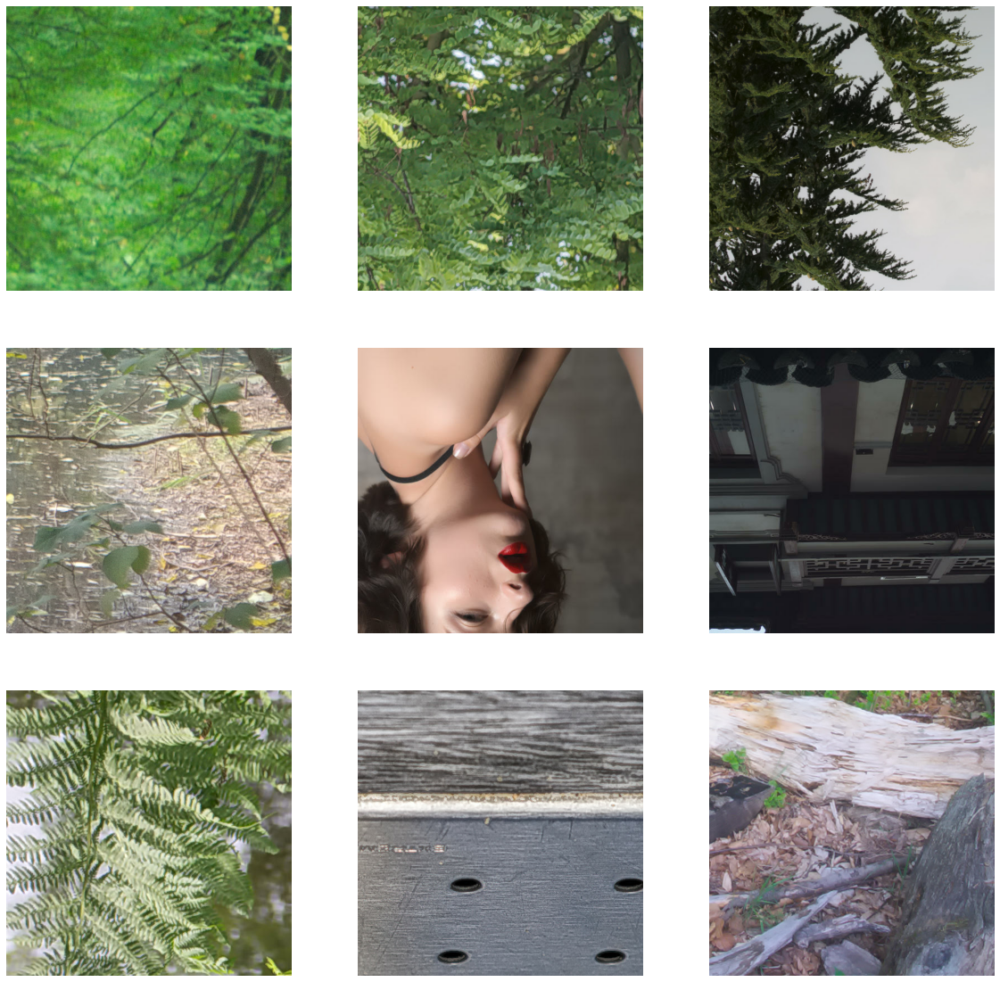

In [15]:
# plotting train images
plt.figure(figsize=(20, 20))
for images, labels in train_dataset.take(1):
    for i in range(9):
        #print(images.shape)
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i])
        plt.axis("off")
        plt.savefig("/kaggle/working/1.png")

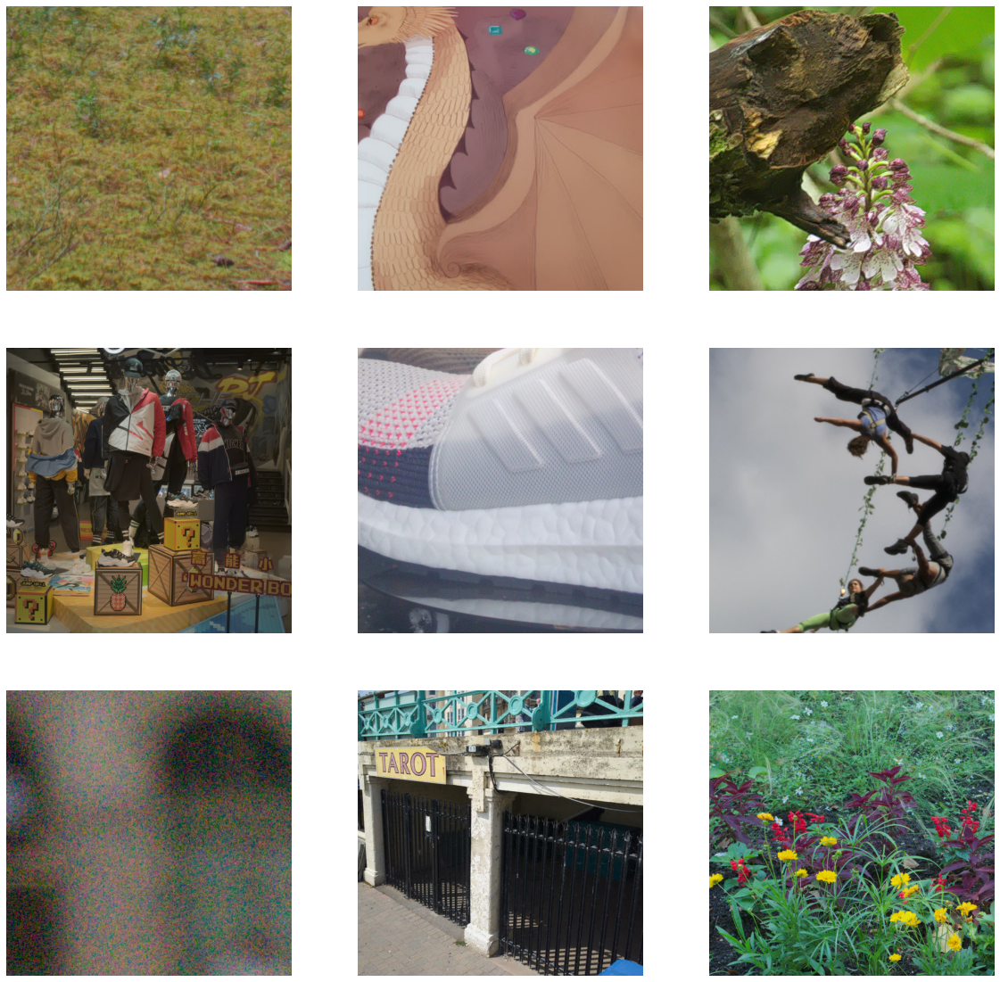

In [16]:
# Plots for valid dataset
plt.figure(figsize=(20, 20))
for images, labels in valid_dataset.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i])
        plt.axis("off")
        plt.savefig("/kaggle/working/2.png")

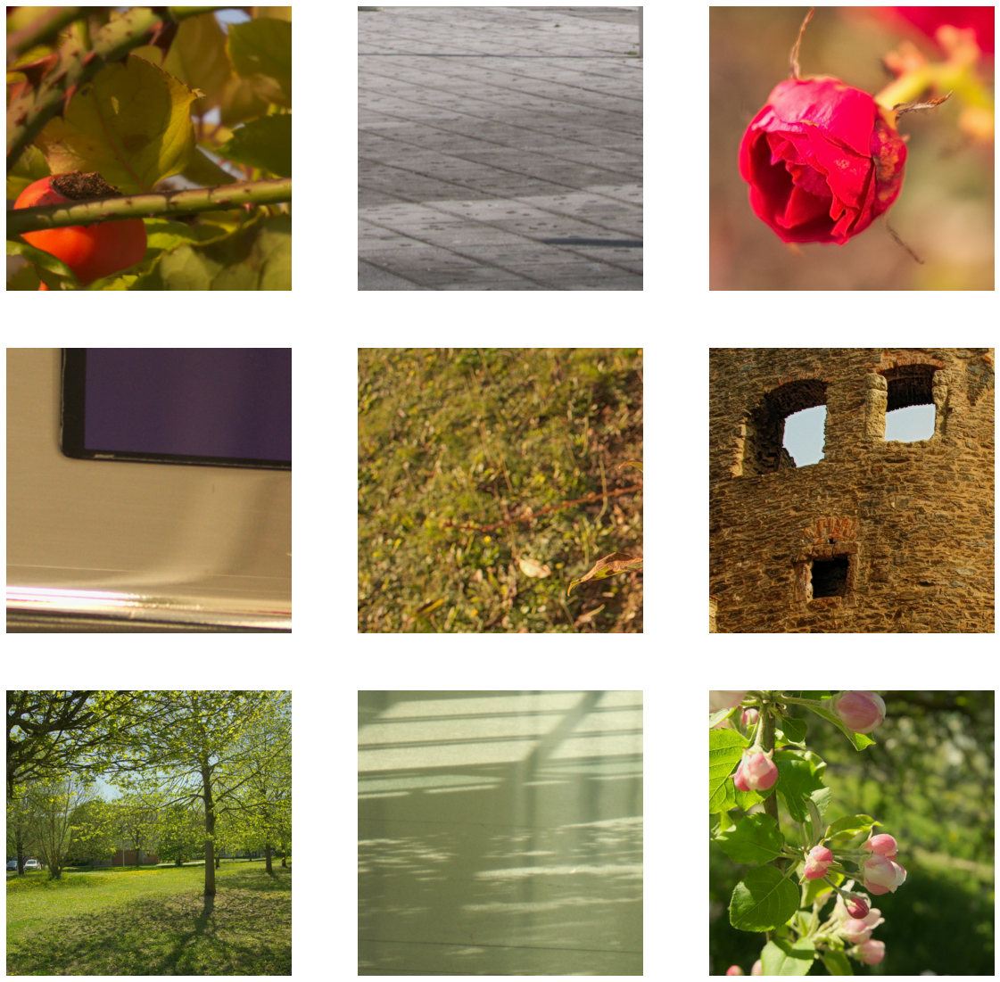

In [17]:
plt.figure(figsize=(20, 20))
for images in test_dataset.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i])
        plt.axis("off")
        plt.savefig("/kaggle/working/3.png")

In [18]:
# Displaying training curves
def displaytrainingcurves(training, validation, title, subplot):
    if subplot%10==1: # set up the subplots on the first call
        plt.subplots(figsize=(15,15), facecolor='#F0F0F0')
        plt.tight_layout()
    ax = plt.subplot(subplot)
    ax.set_facecolor('#F8F8F8')
    ax.plot(training)
    ax.plot(validation)
    ax.set_title(title)
    ax.set_ylabel(title)
    ax.set_xlabel('epoch')
    ax.legend(['train', 'valid.'])

In [19]:
# learning rate scheduler function
def scheduler(epoch):
    if epoch < 3:
        return 0.0005
    elif epoch < 5:
        return 0.0001
    elif epoch < 7:
        return 0.00005
    elif epoch < 9:
        return 0.00003
    elif epoch < 12:
        return 0.00002
    else:
        return 0.00001

lr_callback = tf.keras.callbacks.LearningRateScheduler(scheduler)


In [20]:
# here we are using efficientnetb6 model weights which are already trained on imagenet dataset and benchmarcked 
with strategy.scope():
    B6ns = efn.EfficientNetB6(weights='noisy-student', include_top=False, input_shape=[*IMAGE_SIZE, 3])
    B6ns.trainable = True 
    
    set_trainable = False
    
    # Un-freeze the last 128 layers
    
    for layer in B6ns.layers:
        if layer == B6ns.layers[-128]: 
            set_trainable = True
        if set_trainable:
            layer.trainable = True
        else:
            layer.trainable = False
    
    M_B6ns = tf.keras.Sequential([
        B6ns,
        tf.keras.layers.GlobalAveragePooling2D(),
        tf.keras.layers.Dropout(0.2),
        #tf.keras.layers.Dense(256, activation = 'relu'),
        #tf.keras.layers.Dropout(0.1),
        tf.keras.layers.Dense(1, activation='sigmoid')
    ])

165232640/165226952 [==============================] - 3s 0us/step


In [21]:
# model compilation
M_B6ns.compile(
    optimizer = tf.keras.optimizers.Adam(learning_rate=0.0005, beta_1=0.9, beta_2=0.999, amsgrad=False),
    loss = 'binary_crossentropy',
    metrics=['accuracy']
)
M_B6ns.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
efficientnet-b6 (Model)      (None, 16, 16, 2304)      40960136  
_________________________________________________________________
global_average_pooling2d (Gl (None, 2304)              0         
_________________________________________________________________
dropout (Dropout)            (None, 2304)              0         
_________________________________________________________________
dense (Dense)                (None, 1)                 2305      
Total params: 40,962,441
Trainable params: 23,927,211
Non-trainable params: 17,035,230
_________________________________________________________________


In [22]:
# model fitting
history1 = M_B6ns.fit(train_dataset, steps_per_epoch = train_labels.shape[0] // BATCH_SIZE, epochs=15, callbacks = [lr_callback], validation_data=valid_dataset)

Epoch 1/15
234/234 [==============================] - 2158s 9s/step - loss: 0.6993 - accuracy: 0.4989 - val_loss: 0.6966 - val_accuracy: 0.4949 - lr: 5.0000e-04
Epoch 2/15
234/234 [==============================] - 99s 425ms/step - loss: 0.6963 - accuracy: 0.5035 - val_loss: 0.6940 - val_accuracy: 0.4925 - lr: 5.0000e-04
Epoch 3/15
234/234 [==============================] - 99s 424ms/step - loss: 0.6942 - accuracy: 0.5125 - val_loss: 0.6931 - val_accuracy: 0.4951 - lr: 5.0000e-04
Epoch 4/15
234/234 [==============================] - 99s 424ms/step - loss: 0.6922 - accuracy: 0.5130 - val_loss: 0.6927 - val_accuracy: 0.4983 - lr: 1.0000e-04
Epoch 5/15
234/234 [==============================] - 99s 424ms/step - loss: 0.6906 - accuracy: 0.5206 - val_loss: 0.6938 - val_accuracy: 0.4967 - lr: 1.0000e-04
Epoch 6/15
234/234 [==============================] - 99s 424ms/step - loss: 0.6890 - accuracy: 0.5317 - val_loss: 0.6952 - val_accuracy: 0.4953 - lr: 5.0000e-05
Epoch 7/15
234/234 [=========

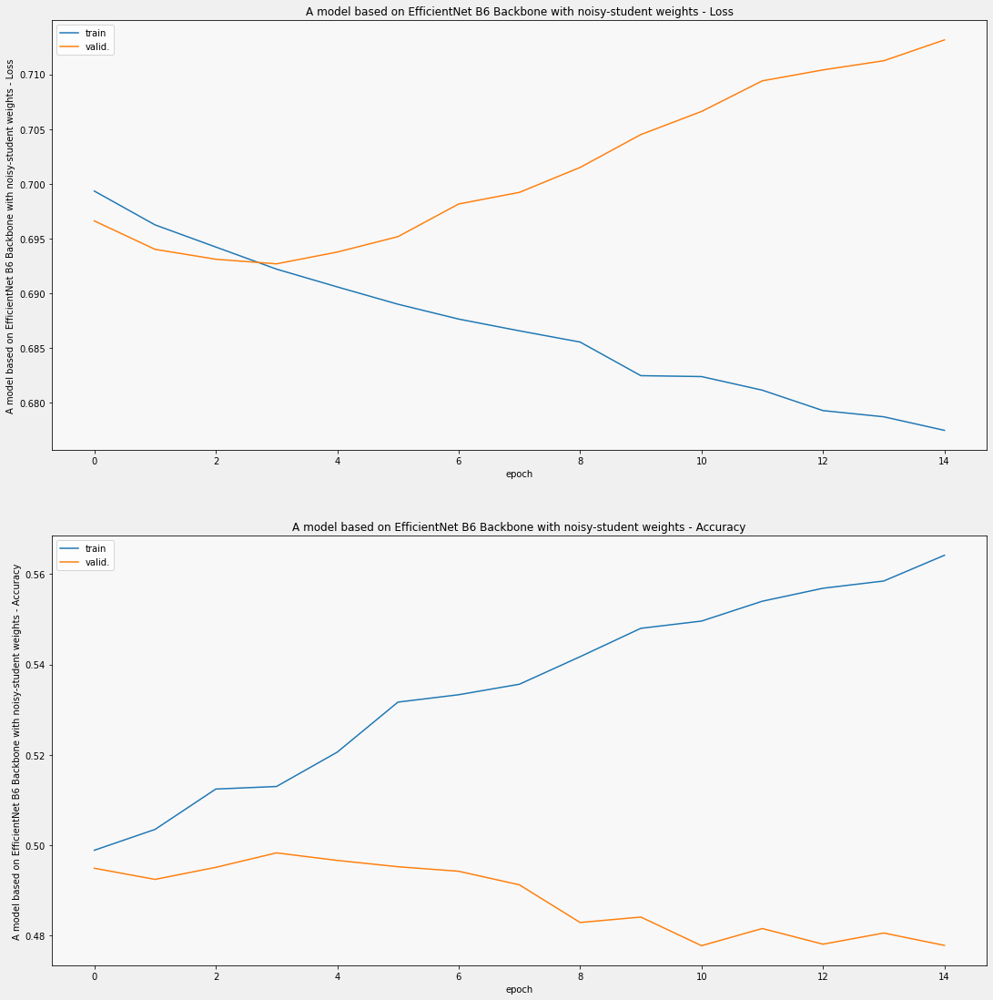

In [23]:
# plots which shows the model loss and accuracies
displaytrainingcurves(history1.history['loss'], history1.history['val_loss'], 'A model based on EfficientNet B6 Backbone with noisy-student weights - Loss', 211)
displaytrainingcurves(history1.history['accuracy'], history1.history['val_accuracy'], 'A model based on EfficientNet B6 Backbone with noisy-student weights - Accuracy', 212)